In [30]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd

In [2]:
df_salaries = pd.read_csv("../data/clean/cleaned_salaries.csv")

In [3]:
df_salaries = df_salaries.drop((['Unnamed: 0']), axis = 1)
df_salaries

,entidadfederativa,montoneto,cargo,area,montobruto,year
0,Hidalgo,4000.00,Fontanero,OBRAS PUBLICAS,4254.00,2018
1,Ciudad de México,12177.86,"AUXILIAR DE ENFERMERIA ""A""",H.G. ENRIQUE CABRERA,16092.00,2018
2,Ciudad de México,11652.00,POLICIA PRIMERO,SUBSECRETARIA DE OPERACION POLICIAL,16030.00,2020
3,Aguascalientes,2644.00,PROF. INVEST. ASOCIADO,DEPORTES,2982.20,2018
4,Aguascalientes,474.96,Docente,"SECUNDARIA TECNICA NUM. 28, RAFAEL VILLEDA HER...",619.00,2019
...,...,...,...,...,...,...
1652156,Federación,16455.00,SUBOFICIAL POLICIA FEDERAL - NIVEL 21,DIVISION DE SEGURIDAD REGIONAL,22142.00,2018
1652157,Chiapas,9984.44,MAESTRO BILINGUE DE EDUCACION PREESCOLAR INDIGENA,ROSARIO CASTELLANOS,12831.86,2018
1652158,Ciudad de México,12119.57,Operativo,Sector 52,13766.68,2019
1652159,Chiapas,7978.94,TECNICO EN ATENCION PRIMARIA A LA SALUD,OFICINA JURISDICCIONAL (PICHUCALCO),20300.52,2020


In [4]:
df_salaries['entidadfederativa'].nunique()

31

In [14]:
aveg_monthly_salary = df_salaries.groupby('year')['montoneto'].mean()

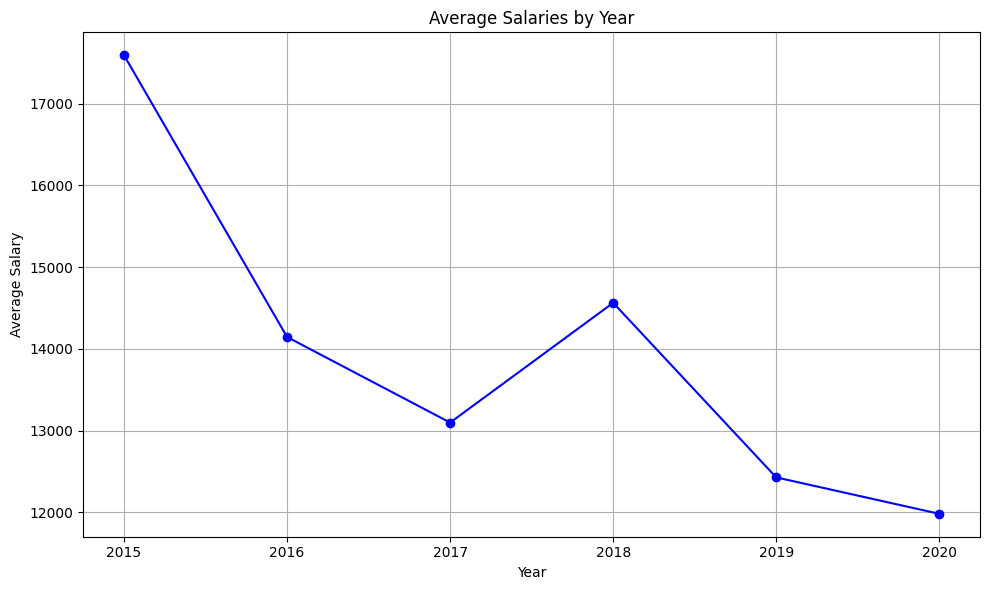

In [15]:
years = aveg_monthly_salary.index
mean_salaries = aveg_monthly_salary.values

plt.figure(figsize=(10, 6))
plt.plot(years, mean_salaries, marker='o', color='blue', linestyle='-')

plt.title('Average Salaries by Year')
plt.xlabel('Year')
plt.ylabel('Average Salary')

plt.grid(True)

plt.tight_layout()
plt.show()

In [6]:
df_salaries.groupby('year')['montoneto'].agg(['count', 'mean', 'std'])

,count,mean,std
year,,,
2015,733,17593.901664,15805.771464
2016,1651,14144.690061,12210.022766
2017,9044,13096.954178,9541.248181
2018,731681,14563.257842,23787.363400
2019,700856,12426.174465,14096.517667
2020,208196,11980.328103,11972.378608


In [35]:
import plotly.express as px
salaly_per_state = df_salaries.groupby('entidadfederativa')['montoneto'].mean().reset_index()

mexican_states_geojson = gpd.read_file('../data/raw/mexico-with-regions_.geojson')

fig = px.choropleth(salaly_per_state,
                    geojson=mexican_states_geojson,
                    locations='entidadfederativa',
                    featureidkey='properties.NAME',  
                    color='montoneto',
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title='Average Monthly Salary per State')

fig.update_layout(
    geo=dict(
        center=dict(lat=24, lon=-102),
        projection_scale=5
    )
)

fig.show()

In [16]:
aveg_state_salary = df_salaries.groupby('entidadfederativa')['montoneto'].agg(['mean'])

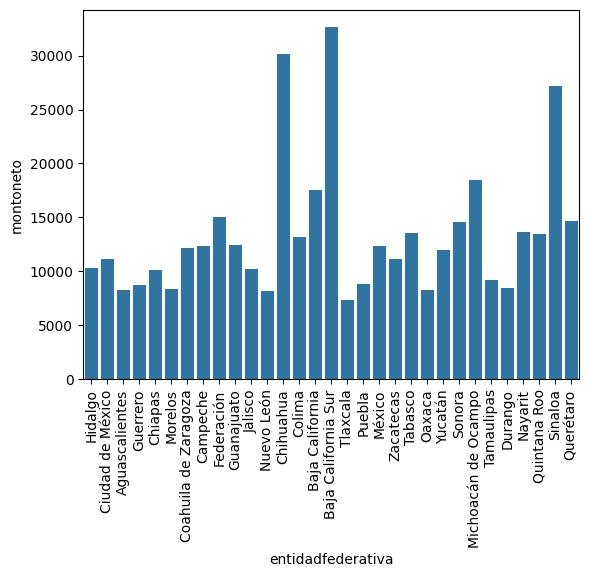

In [44]:
import seaborn as sns

sns.barplot(df_salaries, x="entidadfederativa", y="montoneto", estimator="mean", errorbar=None)
plt.xticks(rotation=90)
plt.show()